# Data Exploration

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as cl

import numpy as np
import scipy.io as scipio
import scipy.ndimage as ndimage
from math import pi,e,log,sqrt
import imageio


In [13]:
# name of the model for easier reference
model = 'M1'
# the title of each column's variable
col_name = "vp vs dn vp/vs qp qs x z"

# load needed files
if(model == 'M1'):
    # Original Earth Model
    input_npz = np.load('../Synthetic Model/input_fields.npz')
    output_smooth_npz = np.load('../Synthetic Model/output_fields_smooth.npz')
    output_npz = np.load('../Synthetic Model/output_fields.npz')
elif(model == 'M5a'):
    # Simplified Earth Model
    input_npz = np.load('../Synthetic Model/Model5a/input_fields.npz')
    output_smooth_npz = np.load('../Synthetic Model/Model5a/output_fields_smooth.npz')
    output_npz = np.load('../Synthetic Model/Model5a/output_fields.npz')
elif(model == 'M5b'):
    # Simplified Earth Model -- less temperature anomaly
    input_npz = np.load('../Synthetic Model/Model5b/input_fields.npz')
    output_smooth_npz = np.load('../Synthetic Model/Model5b/output_fields_smooth.npz')
    output_npz = np.load('../Synthetic Model/Model5b/output_fields.npz')
else:
    # invalid model
    print('Invalid model', model)

In [14]:
X = input_npz['x']
Z = input_npz['z']

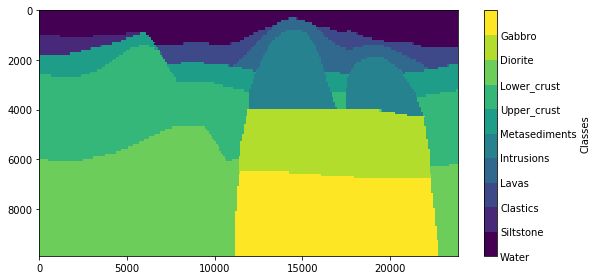

In [15]:
# plot classes
litos = np.asarray([
    'Water',
    'Siltstone',
    'Clastics',
    'Lavas',
    'Intrusions',
    'Metasediments',
    'Upper_crust',
    'Lower_crust',
    'Diorite',
    'Gabbro'])

fig, ax = plt.subplots(1,1,figsize=(8,4))
fig.tight_layout()

# from matplotlib.colors import BoundaryNorm
# from matplotlib.ticker import MaxNLocator
# levels = MaxNLocator(nbins=10).tick_values(0, 11)
cmap = plt.get_cmap('viridis')
norm = cl.BoundaryNorm(range(0,11), ncolors=cmap.N, clip=True)

classes = input_npz['classes']
ax.invert_yaxis()
# im = ax.pcolormesh(X,Z, classes)
im = ax.pcolormesh(X,Z, classes, norm=norm)

cbar = plt.colorbar(im, ax=ax, ticks=range(0,10), label='Classes')
# cbar = plt.colorbar(im, ax=ax)
cbar.ax.tick_params(length=0)
cbar.set_ticklabels(litos)

# cbar.set_label('Classes')

# more distinct color division
# ref : https://matplotlib.org/3.1.0/gallery/images_contours_and_fields/pcolormesh_levels.html

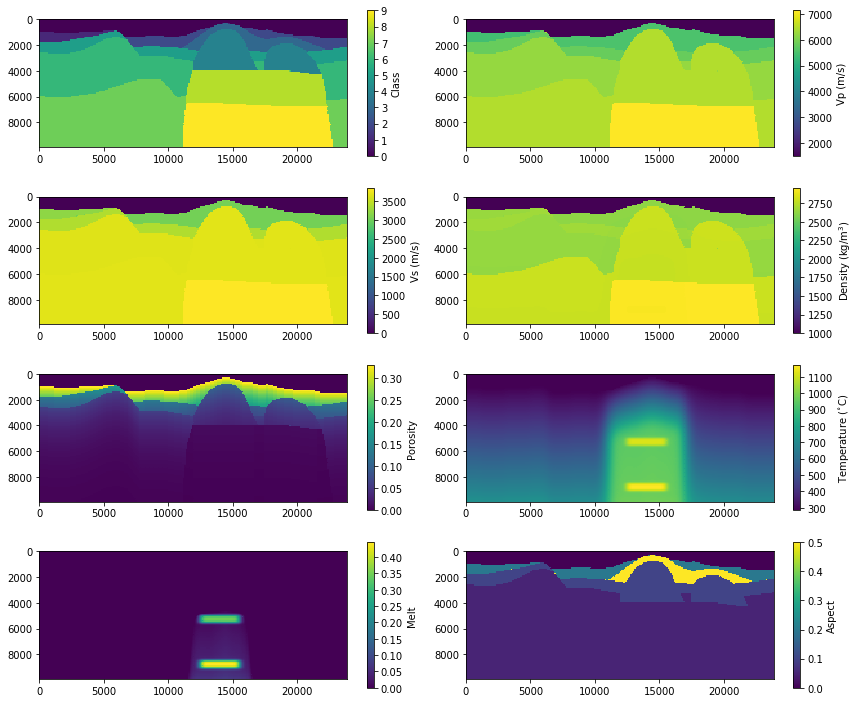

In [16]:
# plot input

fig, axarr = plt.subplots(4,2,figsize=(12,10))
fig.tight_layout()

titles = ['Class', 'Vp (m/s)', 'Vs (m/s)','Density (kg/m$^3$)', 'Porosity', 'Temperature ($^{\circ}$C)', 'Melt', 'Aspect']

for key, title, axs in zip(input_npz.files[:-2], titles, axarr.flatten()):
#     axs.set_title(title)
    val = input_npz[key]
    axs.set_aspect('equal')
    axs.invert_yaxis()
    im = axs.pcolormesh(X,Z,val)
    cbar = plt.colorbar(im, ax=axs)
    cbar.set_label(title)

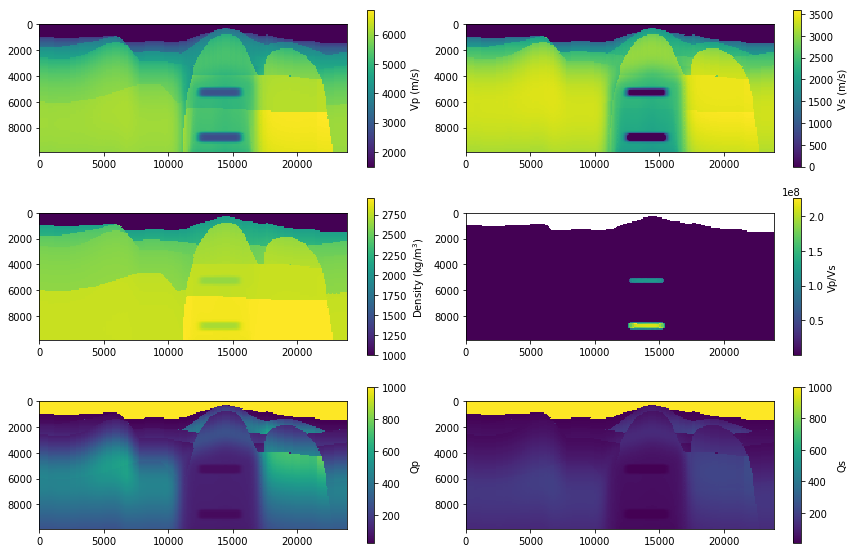

In [8]:
# plot rough output

fig, axarr = plt.subplots(3,2,figsize=(12,8))
fig.tight_layout()

titles = ['Vp (m/s)', 'Vs (m/s)', 'Density (kg/m$^3$)', 'Vp/Vs', 'Qp', 'Qs']

for key, title, axs in zip(output_npz.files[:-2], titles, axarr.flatten()):
#     axs.set_title(title)
    val = output_npz[key]
    axs.set_aspect('equal')
    axs.invert_yaxis()
    im = axs.pcolormesh(X,Z,val)
    cbar = plt.colorbar(im, ax=axs)
    cbar.set_label(title)


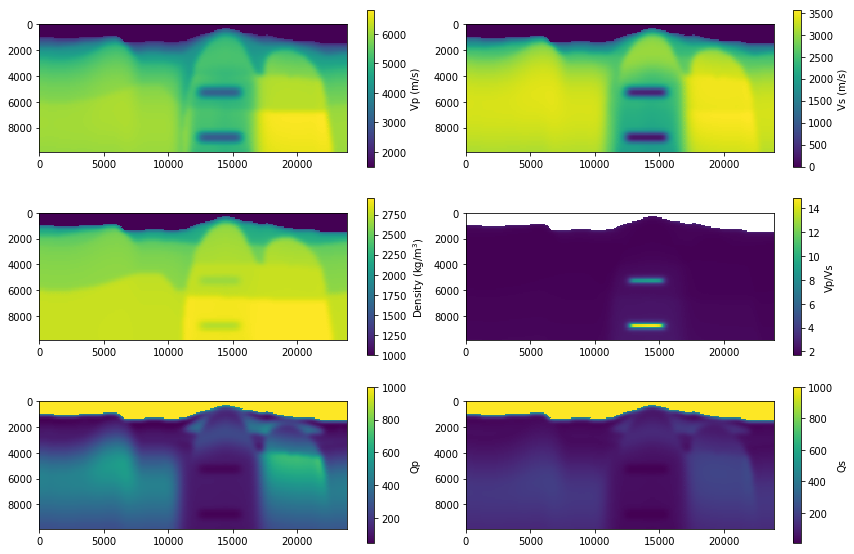

In [11]:
# plot smooth output

fig, axarr = plt.subplots(3,2,figsize=(12,8))
fig.tight_layout()

titles = ['Vp (m/s)', 'Vs (m/s)', 'Density (kg/m$^3$)', 'Vp/Vs', 'Qp', 'Qs']

for key, title, axs in zip(output_smooth_npz.files[:-2], titles, axarr.flatten()):
#     axs.set_title(title)
    val = output_smooth_npz[key]
    axs.set_aspect('equal')
    axs.invert_yaxis()
    im = axs.pcolormesh(X,Z,val)
    cbar = plt.colorbar(im, ax=axs)
    cbar.set_label(title)


In [11]:
#test heatmap
import seaborn as sns
import pandas as pd

In [67]:
#since the data is in 2d, needs to reshape to 1d to find correlation between each parameters

titles = ['Class', 'Vp (m/s)', 'Vs (m/s)', 'Density (kg/m$^3$)', 'Vp/Vs', 'Qp', 'Qs', 'X', 'Z']

for_heatmap = []

val = input_npz['classes']
val = np.reshape(val, val.shape[0] * val.shape[1])
for_heatmap.append(val)

for key, title in zip(output_smooth_npz.files[:-2], titles[1:]):
    val = output_smooth_npz[key]
    print(title)
    print(val.shape, np.nanmin(val), np.nanmax(val))
    val = np.reshape(val, val.shape[0] * val.shape[1])
    for_heatmap.append(val)
#     for_heatmap.append(val[4200:4250])

print(np.array(for_heatmap).shape)

Vp (m/s)
(100, 240) 1500.0 6813.368724840413
Vs (m/s)
(100, 240) 0.0 3565.9579609029797
Density (kg/m$^3$)
(100, 240) 1000.0 2953.3188351472663
Vp/Vs
(100, 240) 1.7030437418545334 inf
Qp
(100, 240) 45.9339507704892 1000.0
Qs
(100, 240) 7.830863626873371 1000.0
(7, 24000)


In [13]:
df = pd.DataFrame(data=np.transpose(for_heatmap),       # values
#                   index=data[1:,0],                     # index
#                   columns=output_smooth_npz.files[:-2]) # column name
                  columns=titles[:-2]) # column name

In [14]:
df.describe()

,Class,Vp (m/s),Vs (m/s),Density (kg/m$^3$),Vp/Vs,Qp,Qs
count,24000.000000,24000.000000,24000.000000,24000.000000,2.400000e+04,24000.000000,24000.000000
mean,5.781542,4981.343752,2556.471007,2498.794285,inf,369.956160,208.223427
std,2.733977,1511.966154,1084.756614,565.539848,NaN,264.293822,281.727557
min,0.000000,1500.000000,0.000000,1000.000000,1.703044e+00,45.933951,7.830864
25%,4.000000,4516.123630,2230.700936,2538.910781,1.754816e+00,157.197658,61.546866
50%,7.000000,5460.838987,3042.466603,2722.711241,1.841424e+00,323.678160,126.358837
75%,8.000000,6052.351012,3320.002167,2791.698042,2.080682e+00,455.414736,167.158162
max,9.000000,6813.368725,3565.957961,2953.318835,inf,1000.000000,1000.000000


In [15]:
df.corr()

,Class,Vp (m/s),Vs (m/s),Density (kg/m$^3$),Vp/Vs,Qp,Qs
Class,1.000000,0.852294,0.717944,0.904596,0.209375,-0.548601,-0.723282
Vp (m/s),0.852294,1.000000,0.963352,0.929164,-0.308765,-0.460015,-0.743794
Vs (m/s),0.717944,0.963352,1.000000,0.872801,-0.554026,-0.461786,-0.757643
Density (kg/m$^3$),0.904596,0.929164,0.872801,1.000000,0.052105,-0.717851,-0.906847
Vp/Vs,0.209375,-0.308765,-0.554026,0.052105,1.000000,-0.258277,-0.187465
Qp,-0.548601,-0.460015,-0.461786,-0.717851,-0.258277,1.000000,0.907242
Qs,-0.723282,-0.743794,-0.757643,-0.906847,-0.187465,0.907242,1.000000


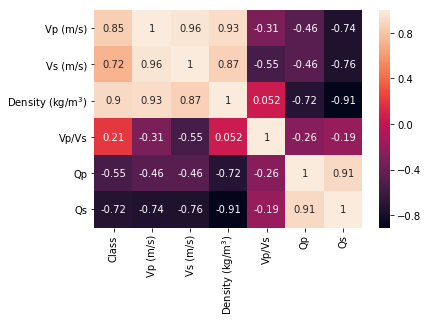

In [16]:
sns.heatmap(df.corr()[1:],annot=True)

Plotting the histogram Vp (m/s) of each class.
Plotting the histogram Vs (m/s) of each class.
Plotting the histogram Density (kg/m$^3$) of each class.
Plotting the histogram Qp of each class.
Plotting the histogram Qs of each class.


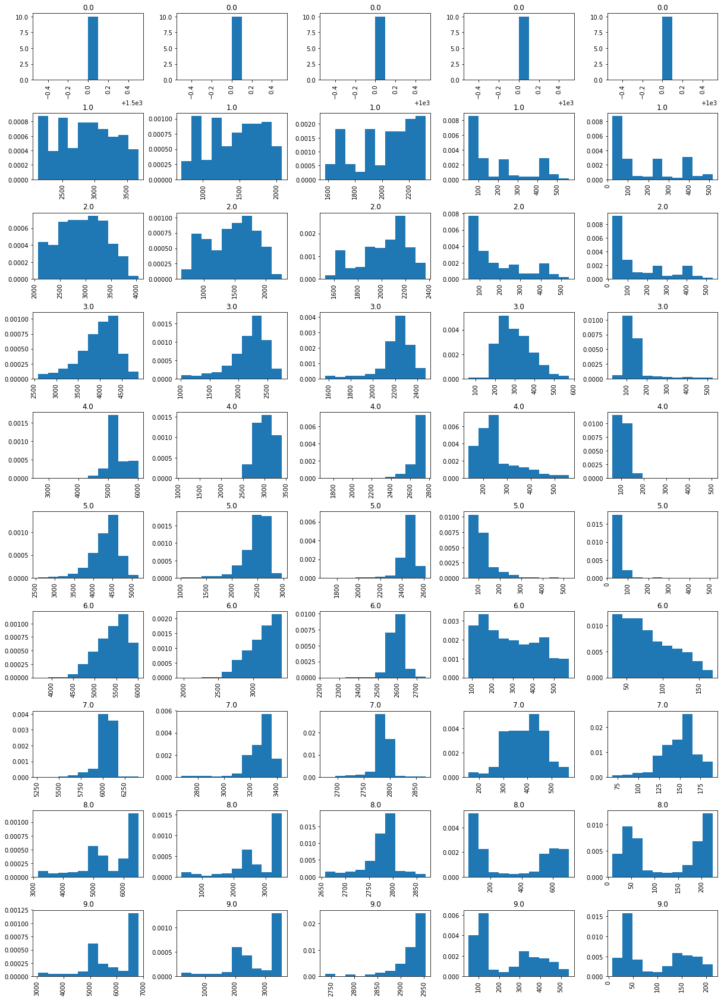

In [64]:
# Plot histogram of each graph

# fig, ax = plt.subplots(1,6,figsize=(12,8))
fig, ax = plt.subplots(ncols=5, nrows=10,sharey=False, figsize=(20,30))
fig.tight_layout()
# Plot histogram of each graph
for i,ii in zip([1,2,3,5,6],range(5)):
    print("Plotting the histogram", titles[i], "of each class.")
    df.hist(column=titles[i], by=titles[0], figsize=(4,20), ax=ax[:,ii], density=1) 

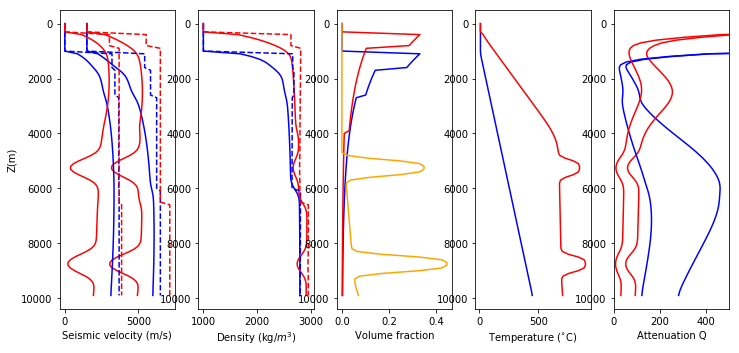

In [19]:
kelvin=273.15

cx1, cx2 = 20, 150

fig3 = plt.figure(figsize=(12,5.5))
ax1 = fig3.add_subplot(151)
plt.plot(output_smooth_npz['vps'][:,cx1],Z,color='blue')
plt.plot(output_smooth_npz['vps'][:,cx2],Z,color='red')
plt.plot(input_npz['vp0'][:,cx1],Z,color='blue',ls="--")
plt.plot(input_npz['vp0'][:,cx2],Z,color='red',ls="--")
plt.plot(output_smooth_npz['vss'][:,cx1],Z,color='blue')
plt.plot(output_smooth_npz['vss'][:,cx2],Z,color='red')
plt.plot(input_npz['vs0'][:,cx1],Z,color='blue',ls="--")
plt.plot(input_npz['vs0'][:,cx2],Z,color='red',ls="--")
plt.ylabel("Z(m)")
plt.xlabel("Seismic velocity (m/s)")
ax1.invert_yaxis()

ax2 = fig3.add_subplot(152)
plt.plot(output_smooth_npz['dns'][:,cx1],Z,color='blue')
plt.plot(output_smooth_npz['dns'][:,cx2],Z,color='red')
plt.plot(input_npz['dn0'][:,cx1],Z,color='blue',ls="--")
plt.plot(input_npz['dn0'][:,cx2],Z,color='red',ls="--")
plt.xlabel("Density (kg/$m^3$)")
ax2.invert_yaxis()

ax3 = fig3.add_subplot(153)
plt.plot(input_npz['por'][:,cx1],Z,color='blue')
plt.plot(input_npz['por'][:,cx2],Z,color='red')
plt.plot(input_npz['melt'][:,cx2],Z,color='orange')
plt.xlabel("Volume fraction")
ax3.invert_yaxis()

ax4 = fig3.add_subplot(154)
plt.plot(input_npz['temp'][:,cx1]-kelvin,Z,color='blue')
plt.plot(input_npz['temp'][:,cx2]-kelvin,Z,color='red')
plt.xlabel("Temperature ($^{\circ}$C)")
ax4.invert_yaxis()

ax5 = fig3.add_subplot(155)
plt.plot(output_smooth_npz['qps'][:,cx1],Z,color='blue')
plt.plot(output_smooth_npz['qps'][:,cx2],Z,color='red')
plt.plot(output_smooth_npz['qss'][:,cx1],Z,color='blue')
plt.plot(output_smooth_npz['qss'][:,cx2],Z,color='red')
plt.xlabel("Attenuation Q")
plt.xlim(0,500)
ax5.invert_yaxis()

# fileplot='fig3_vsections.pdf'
# plt.tight_layout()
# plt.savefig(fileplot,dpi=300)

plt.show()

In [20]:
# import for animation

from matplotlib import animation
from IPython.display import HTML

In [21]:
# animate crossectional
def init():
    L_Ivp.set_data([], [])
    L_Ivs.set_data([], [])
    L_Avp.set_data([], [])
    L_Avs.set_data([], [])
    
    L_Idn.set_data([], [])
    L_Adn.set_data([], [])
    L_por.set_data([], [])
    L_mlt.set_data([], [])
    
    L_tmp.set_data([], [])
    
    L_Aqp.set_data([], [])
    L_Aqs.set_data([], [])

    time_text.set_text('')
    return L_Ivp, L_Ivs, L_Avp, L_Avs, L_Idn, L_Adn, L_por, L_mlt, L_tmp, L_Aqp, L_Aqs, time_text


def animate(i):
    L_Ivp.set_data(Ivp[:,i] , Z)
    L_Ivs.set_data(Ivs[:,i] , Z)
    L_Avp.set_data(Avp[:,i] , Z)
    L_Avs.set_data(Avs[:,i] , Z)

    L_Idn.set_data(Idn[:,i] , Z)
    L_Adn.set_data(Adn[:,i] , Z)
    
    L_por.set_data(por[:,i] , Z)
    L_mlt.set_data(mlt[:,i] , Z)
    
    L_tmp.set_data(tmp[:,i] , Z)
    
    L_Aqp.set_data(Aqp[:,i] , Z)
    L_Aqs.set_data(Aqs[:,i] , Z)

    time_text.set_text('x = %d' % X[i])
    return L_Ivp, L_Ivs, L_Avp, L_Avs, L_Idn, L_Adn, L_por, L_mlt, L_tmp, L_Aqp, L_Aqs, time_text

In [22]:
# animate multiple plots of smoothen model
# exampled from here: http://www.roboticslab.ca/wp-content/uploads/2012/11/robotics_lab_animation_example.txt

Ivp = input_npz['vp0']
Ivs = input_npz['vs0']
Avp = output_smooth_npz['vps']
Avs = output_smooth_npz['vss']

Idn = input_npz['dn0']
Adn = output_smooth_npz['dns']

por = input_npz['por']
mlt = input_npz['melt']

tmp = input_npz['temp']

Aqp = output_smooth_npz['qps']
Aqs = output_smooth_npz['qss']

fig = plt.figure(figsize=(12, 5.5))

ax1 = fig.add_subplot(151, xlim=(np.nanmin(np.array([Ivp, Ivs, Avp, Avs])), 
                                 np.nanmax(np.array([Ivp, Ivs, Avp, Avs]))), 
                      ylim=(0, 10000),
                      xlabel='Seismic velocity (m/s)', ylabel='$Depth(m)$')

ax2 = fig.add_subplot(152, xlim=(np.nanmin(np.array([Idn, Adn])), 
                                 np.nanmax(np.array([Idn, Adn]))), 
                                 ylim=(0, 10000),
                      xlabel='Density (kg/$m^3$)')

ax3 = fig.add_subplot(153, xlim=(np.nanmin(np.array([por, mlt])), 
                                 np.nanmax(np.array([por, mlt]))), 
                      ylim=(0, 10000),
                      xlabel='Volume fraction')

ax4 = fig.add_subplot(154, xlim=(np.nanmin(tmp), np.nanmax(tmp)), 
                      ylim=(0, 10000),
                      xlabel='Temperature ($^{\circ}$C)')

ax5 = fig.add_subplot(155, xlim=(np.nanmin(np.array([Aqp, Aqs])), 
                                 np.nanmax(np.array([Aqp, Aqs]))), 
                      ylim=(0, 10000),
                      xlabel='Attenuation Q')

ax1.invert_yaxis()
ax2.invert_yaxis()
ax3.invert_yaxis()
ax4.invert_yaxis()
ax5.invert_yaxis()

fig.tight_layout()

# if we don't close the figure here we get a rogue frame under the movie
plt.close()

time_text = ax1.text(0.1, 0.1, '', transform=ax1.transAxes)

L_Ivp, = ax1.plot([], [], color='blue', lw=2, ls="--")
L_Ivs, = ax1.plot([], [], color='red', lw=2, ls="--")
L_Avp, = ax1.plot([], [], color='blue', lw=2)
L_Avs, = ax1.plot([], [], color='red', lw=2)

L_Idn, = ax2.plot([], [], color='red', lw=2, ls="--")
L_Adn, = ax2.plot([], [], color='red', lw=2)
                      
L_por, = ax3.plot([], [], color='red', lw=2)
L_mlt, = ax3.plot([], [], color='blue', lw=2)
                      
L_tmp, = ax4.plot([], [], color='red', lw=2)
    
L_Aqp, = ax5.plot([], [], color='blue', lw=2)
L_Aqs, = ax5.plot([], [], color='red', lw=2)

frames = np.arange(0, Ivp.shape[1], 1)
anim = animation.FuncAnimation(fig, animate, frames,
                           interval=len(X), blit=True, init_func=init)

HTML(anim.to_jshtml())

In [23]:
value = Adn
# animate crossectional for one property
def init_1plot():
    line.set_data([], [])

    time_text.set_text('')
    return line, time_text


def animate_1plot(i):
    line.set_data(value[:,i] , Z)

    time_text.set_text('x = %d' % X[i])
    return line, time_text

In [24]:
# Individual plot, alter the property you wanted to plot here :)

fig = plt.figure(figsize=(4, 5.5))
ax1 = fig.add_subplot(111, xlim=(np.nanmin(Adn), np.nanmax(Adn)), ylim=(0, 10000),
                      xlabel='$Density$', ylabel='$Depth$',
                      title='Cross Sectional Animate')
ax1.invert_yaxis()
fig.tight_layout()

# if we don't close the figure here we get a rogue frame under the movie
plt.close()

line, = ax1.plot([], [], 'b', lw=2)
time_text = ax1.text(0.1, 0.1, '', transform=ax1.transAxes)

frames = np.arange(0, value.shape[1], 1)
anim = animation.FuncAnimation(fig, animate_1plot, frames,
                           interval=len(X), blit=True, init_func=init_1plot)

HTML(anim.to_jshtml())

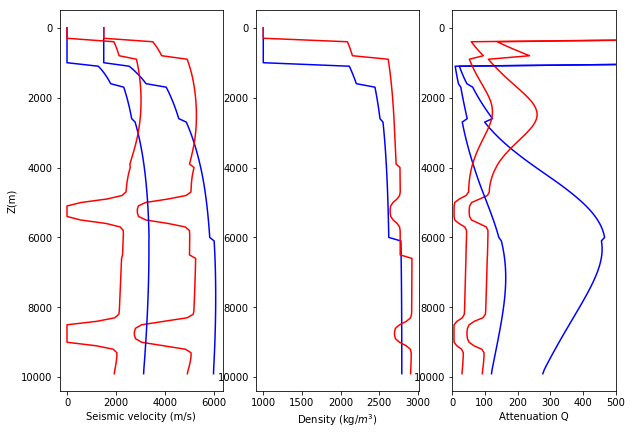

In [18]:
#plot non-smoothen data at x = 15000
kelvin=273.15

cx1, cx2 = 20, 150

fig3 = plt.figure(figsize=(17,7))
ax1 = fig3.add_subplot(151)
plt.plot(output_npz['vp'][:,cx1],Z,color='blue')
plt.plot(output_npz['vp'][:,cx2],Z,color='red')
# plt.plot(input_npz['vp0'][:,cx1],Z,color='blue',ls="--")
# plt.plot(input_npz['vp0'][:,cx2],Z,color='red',ls="--")
plt.plot(output_npz['vs'][:,cx1],Z,color='blue')
plt.plot(output_npz['vs'][:,cx2],Z,color='red')
# plt.plot(input_npz['vs0'][:,cx1],Z,color='blue',ls="--")
# plt.plot(input_npz['vs0'][:,cx2],Z,color='red',ls="--")
plt.ylabel("Z(m)")
plt.xlabel("Seismic velocity (m/s)")
ax1.invert_yaxis()

ax2 = fig3.add_subplot(152)
plt.plot(output_npz['dn'][:,cx1],Z,color='blue')
plt.plot(output_npz['dn'][:,cx2],Z,color='red')
# plt.plot(input_npz['dn0'][:,cx1],Z,color='blue',ls="--")
# plt.plot(input_npz['dn0'][:,cx2],Z,color='red',ls="--")
plt.xlabel("Density (kg/$m^3$)")
ax2.invert_yaxis()

# ax3 = fig3.add_subplot(153)
# plt.plot(input_npz['por'][:,cx1],Z,color='blue')
# plt.plot(input_npz['por'][:,cx2],Z,color='red')
# plt.plot(input_npz['melt'][:,cx2],Z,color='orange')
# plt.xlabel("Volume fraction")
# ax3.invert_yaxis()

# ax4 = fig3.add_subplot(154)
# plt.plot(input_npz['temp'][:,cx1]-kelvin,Z,color='blue')
# plt.plot(input_npz['temp'][:,cx2]-kelvin,Z,color='red')
# plt.xlabel("Temperature ($^{\circ}$C)")
# ax4.invert_yaxis()

ax5 = fig3.add_subplot(153)
plt.plot(output_npz['qp'][:,cx1],Z,color='blue')
plt.plot(output_npz['qp'][:,cx2],Z,color='red')
plt.plot(output_npz['qs'][:,cx1],Z,color='blue')
plt.plot(output_npz['qs'][:,cx2],Z,color='red')
plt.xlabel("Attenuation Q")
plt.xlim(0,500)
ax5.invert_yaxis()

# fileplot='fig3_vsections.pdf'
# plt.tight_layout()
# plt.savefig(fileplot,dpi=300)

plt.show()